In [2]:
import numpy as np
import os
import matplotlib.pyplot as plt
from tqdm import tqdm 
from datetime import datetime, timedelta
import rasterio

In [4]:
coordinates = np.load('/mnt/data1tb/brios/brios/datasets/coordinates.npy')
coordinates[160739]

array([341, 469])

In [7]:
ndvi_root = np.load('/mnt/data1tb/brios/brios/datasets/data2/ndvi_timeseries.npy')
ndvi_root.shape

(342, 470, 46)

In [8]:
ndvi_root[21, 129, 30]

0.7428880333900452

/tmp/ipykernel_9994/4254119468.py:13: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend()


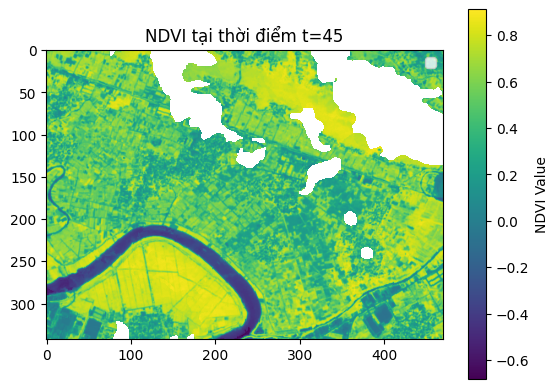

In [11]:
import matplotlib.pyplot as plt
import numpy as np

# Giả sử ndvi_root là mảng NDVI với shape (x, y, t)
# Truy cập NDVI tại pixel (21, 129) cho thời điểm 30
pixel_x, pixel_y, time_t = 21, 129, 45
ndvi_value = ndvi_root[pixel_x, pixel_y, time_t]

# Vẽ NDVI tại thời điểm đã chọn
plt.imshow(ndvi_root[:, :, time_t], cmap='viridis')
plt.colorbar(label="NDVI Value")
plt.title(f"NDVI tại thời điểm t={time_t}")
plt.legend()
plt.show()

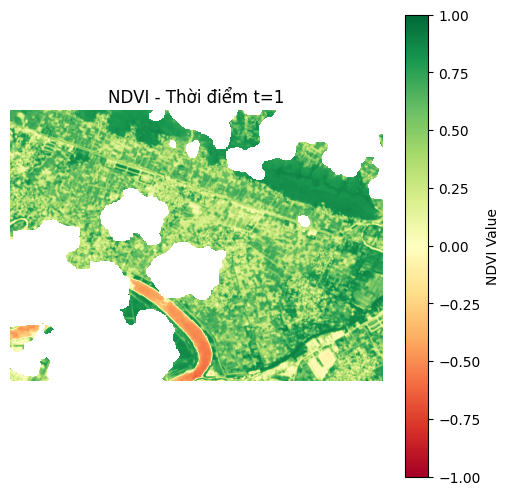

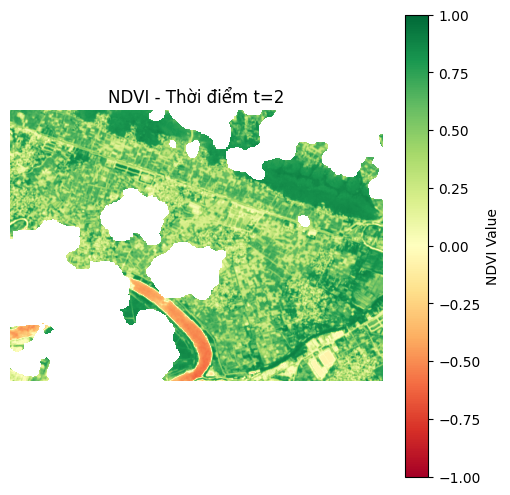

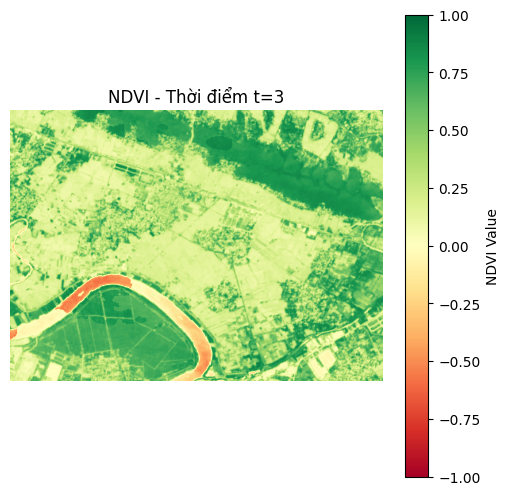

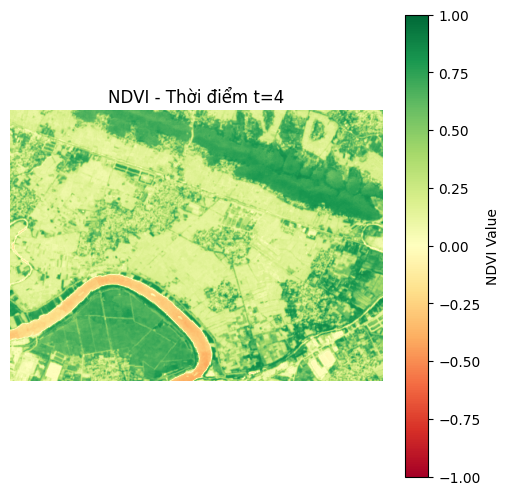

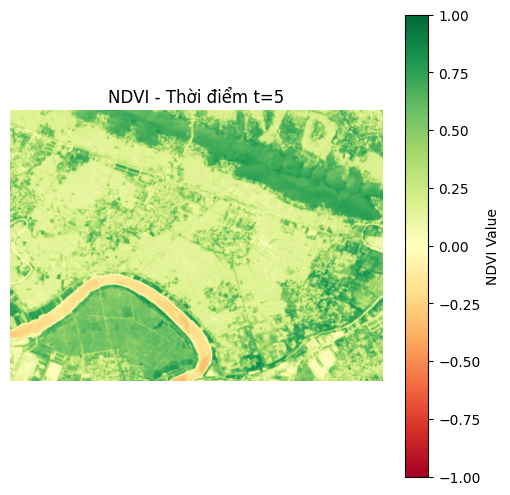

...

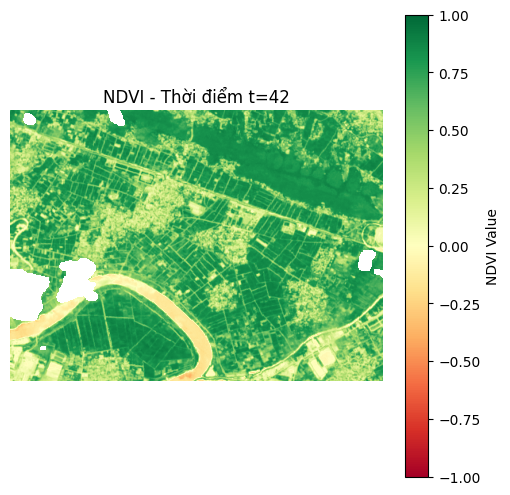

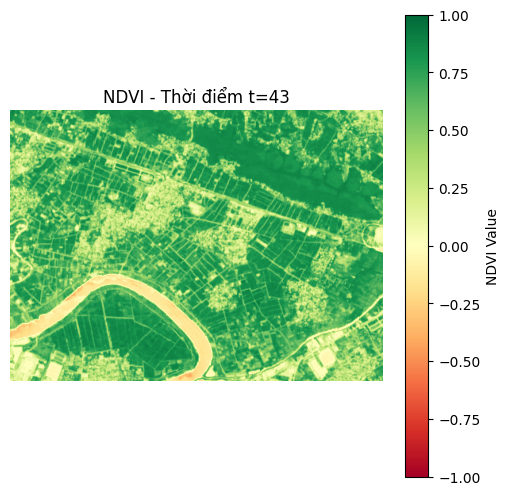

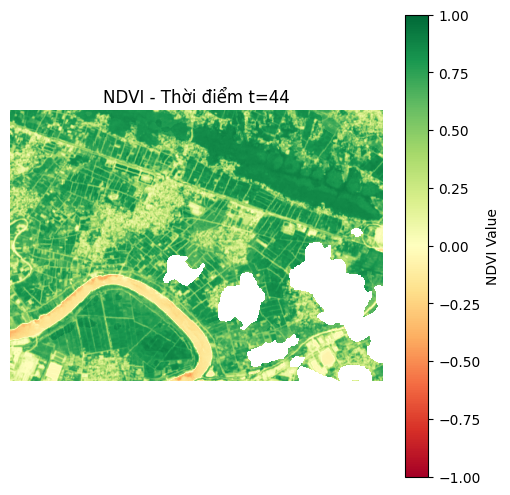

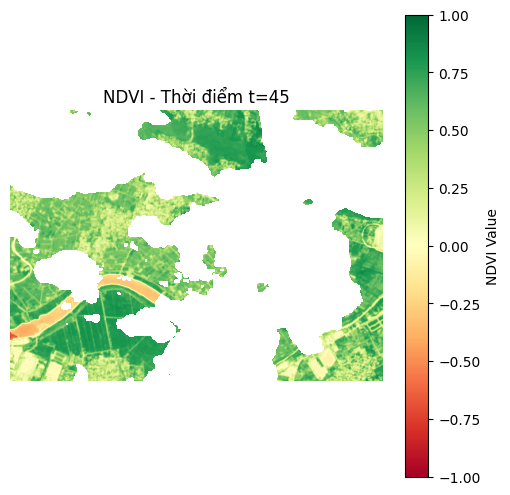

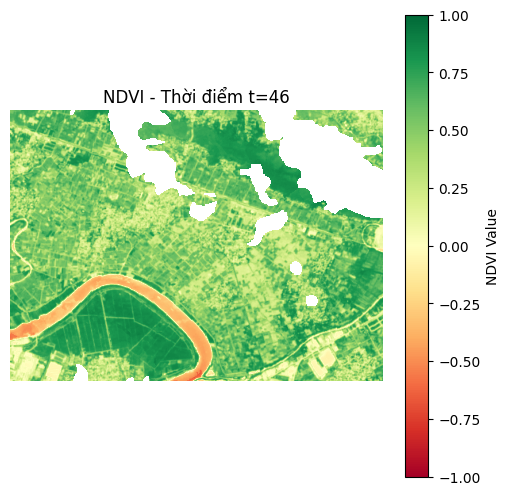

In [12]:
import matplotlib.pyplot as plt
import numpy as np

# Giả sử ndvi_root là mảng NDVI với shape (x, y, t)
num_timesteps = ndvi_root.shape[2]

# Lặp qua từng thời điểm và tạo một figure cho mỗi ảnh
for t in range(num_timesteps):
    plt.figure(figsize=(6, 6))
    plt.imshow(ndvi_root[:, :, t], cmap='RdYlGn', vmin=-1, vmax=1)
    plt.colorbar(label="NDVI Value")
    plt.title(f"NDVI - Thời điểm t={t+1}")
    plt.axis('off')  # Tắt các trục để ảnh rõ ràng hơn
    plt.show()


In [13]:
test=np.load('/mnt/data1tb/brios/brios/BRIOS/results/anphu_haiduong/anphu_attention.npy')

In [14]:
test = test.reshape((test.shape[0], test.shape[1]))

In [15]:
test.shape

(160740, 46)

In [16]:
np.where(test==-100)

(array([], dtype=int64), array([], dtype=int64))

In [17]:
ndvi_root.shape

(342, 470, 46)

In [18]:
img1 = np.zeros((ndvi_root.shape[0], ndvi_root.shape[1]), dtype=np.float16)

In [19]:
img1.shape

(342, 470)

In [20]:
coordinates[0]

array([0, 0])

In [21]:
for i in range(test.shape[0]):
    img1[coordinates[i, 0], coordinates[i,1]] = test[i, 45]

In [22]:
print(img1)

[[0.5234  0.5293  0.5303  ... 0.5054  0.506   0.581  ]
 [0.514   0.5254  0.523   ... 0.3528  0.426   0.434  ]
 [0.5327  0.526   0.526   ... 0.2499  0.3953  0.434  ]
 ...
 [0.1519  0.1367  0.1344  ... 0.3792  0.3452  0.674  ]
 [0.0514  0.05563 0.0548  ... 0.4182  0.359   0.7    ]
 [0.0494  0.      0.0699  ... 0.6055  0.5815  0.7007 ]]


In [23]:
img1.shape

(342, 470)

In [24]:
img1 = np.zeros((ndvi_root.shape[0], ndvi_root.shape[1], 46))  # Hoặc np.full((x_size, y_size, 46), np.nan)

# Gán giá trị từ `test` vào `img1` ở các tọa độ và thời điểm khác nhau
for i in range(test.shape[0]):
    for t in range(test.shape[1]):  # Với `t` là chiều thời gian trong `test`
        img1[coordinates[i, 0], coordinates[i, 1], t] = test[i, t]

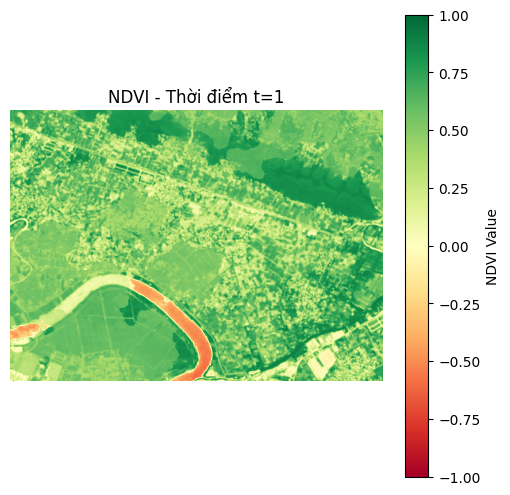

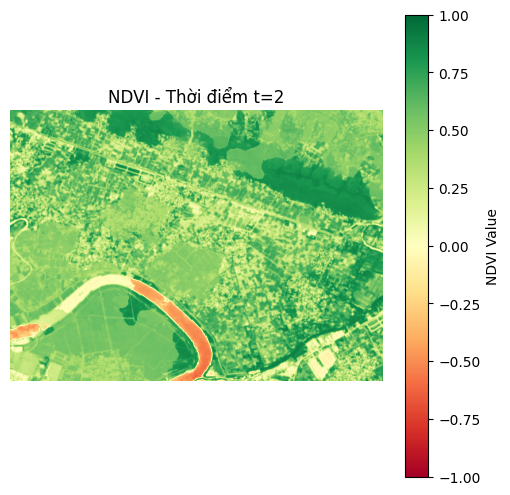

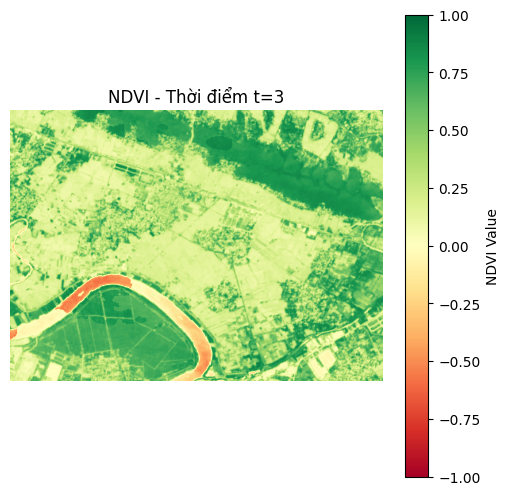

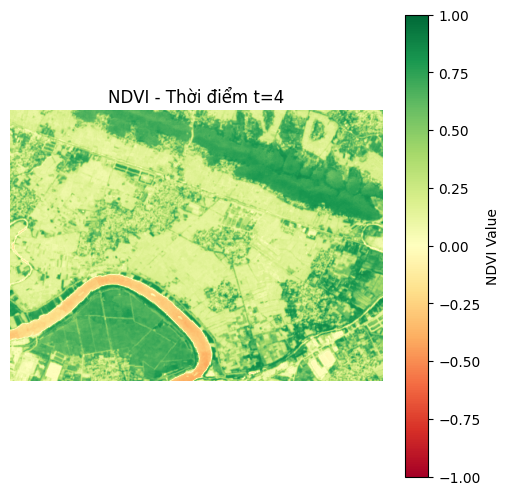

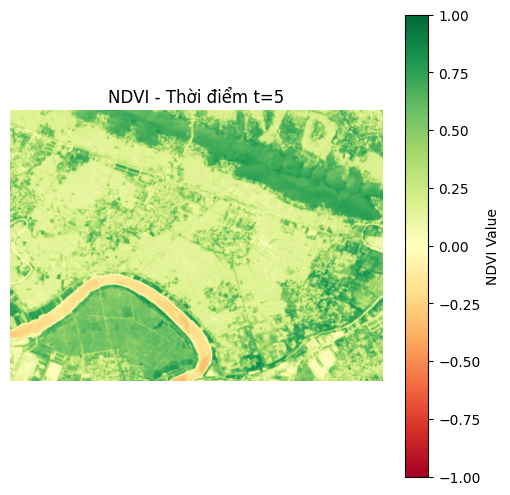

...

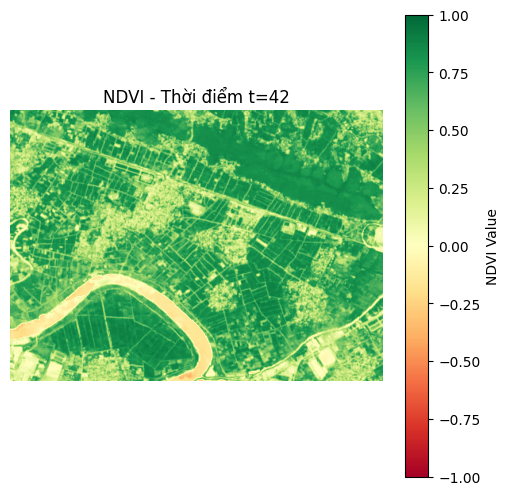

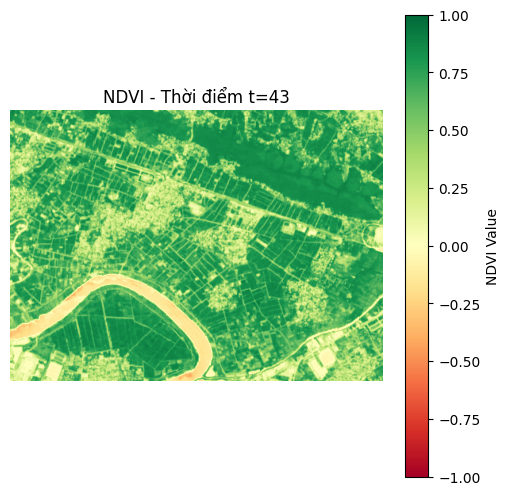

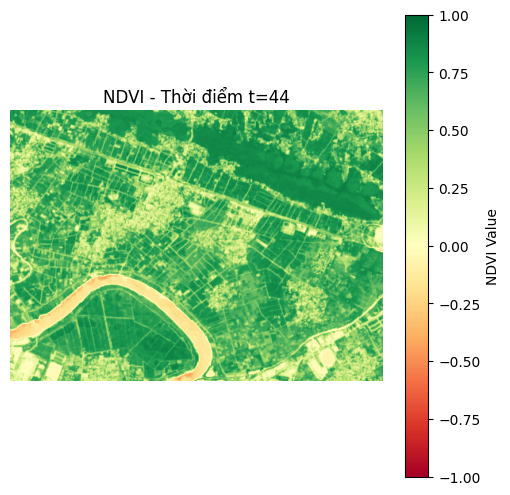

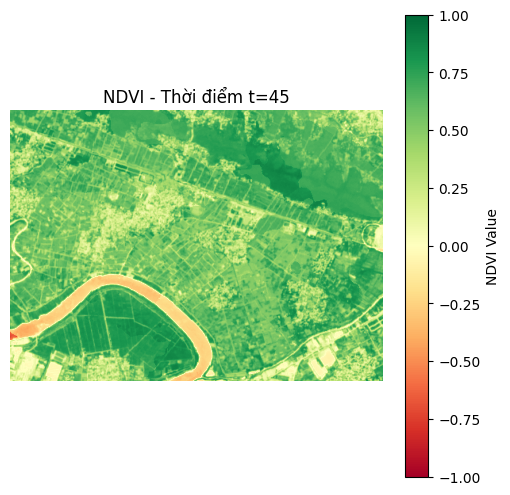

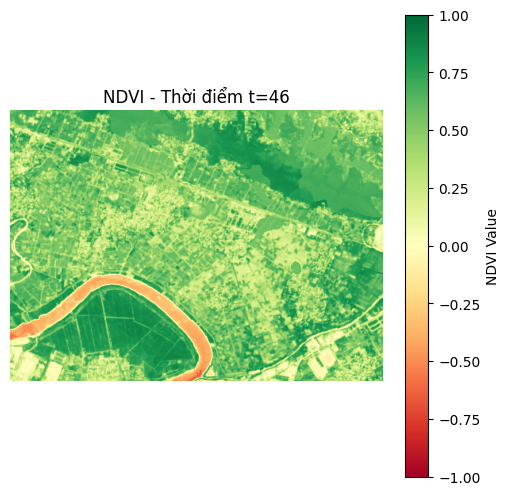

In [25]:
import matplotlib.pyplot as plt
import numpy as np

# Giả sử ndvi_root là mảng NDVI với shape (x, y, t)
num_timesteps = ndvi_root.shape[2]

# Lặp qua từng thời điểm và tạo một figure cho mỗi ảnh
for t in range(num_timesteps):
    plt.figure(figsize=(6, 6))
    plt.imshow(img1[:, :, t], cmap='RdYlGn', vmin=-1, vmax=1)
    plt.colorbar(label="NDVI Value")
    plt.title(f"NDVI - Thời điểm t={t+1}")
    plt.axis('off')  # Tắt các trục để ảnh rõ ràng hơn
    plt.show()


In [27]:
ndvi_root_time_series = ndvi_root.reshape(160740, 46)
ndvi_root_time_series.shape

(160740, 46)

In [28]:
time_series_less_null = []
for i in range(16740):
    cnt = 0
    for j in range(46):
        if not np.isnan(ndvi_root_time_series[i, j]):
            cnt += 1
    if cnt >= 32:   
        time_series_less_null.append(i)

# np.save('/mnt/data1tb/BRIOS/data2/anphu_less_null.npy', time_series_less_null)
len(time_series_less_null)

1384

In [35]:
changed_positions_25 = np.load('/mnt/data1tb/brios/brios/datasets/dataTrain/changed_positions_25.npy')

changed_positions_25[1]

array([False, False, False, False, False, False, False,  True, False,
       False, False,  True, False, False, False, False, False, False,
        True, False,  True,  True, False, False, False, False, False,
       False,  True, False, False, False,  True, False, False, False,
       False, False, False, False, False, False, False, False,  True,
       False])

In [36]:
test_25 = np.load('/mnt/data1tb/brios/brios/BRIOS/results/anphu_haiduong/anphu_attention_25.npy')

In [37]:
anphu_less_null = np.load('/mnt/data1tb/brios/brios/datasets/dataTrain/anphu_less_null.npy')
anphu_less_null.shape

(1384,)

In [38]:
test_25.shape

(1384, 46, 1)

In [39]:
squared_errors = []
for i in range(test_25.shape[0]):
    for t in range(test_25.shape[1]):
        if changed_positions_25[i, t]:
            y_root = ndvi_root_time_series[[anphu_less_null[i]], t]
            y_pred = test_25[i, t, 0]
            print(f'y root {y_root} y pred {y_pred}')
            squared_errors.append((y_root - y_pred) ** 2)

rmse = np.sqrt(np.mean(squared_errors))

print("RMSE:", rmse)


y root [0.42532909] y pred 0.4409841299057007
y root [0.43296704] y pred 0.446283221244812
y root [0.19717787] y pred 0.29876580834388733
y root [0.19717787] y pred 0.2805371880531311
y root [0.35159817] y pred 0.33145013451576233
y root [0.27272728] y pred 0.29576486349105835
y root [0.27344027] y pred 0.5213719606399536
y root [0.27344027] y pred 0.5162802934646606
y root [0.41167316] y pred 0.5047166347503662
y root [0.48336449] y pred 0.4426214098930359
y root [0.24235901] y pred 0.335349440574646
y root [0.2331467] y pred 0.3086933493614197
y root [0.25467497] y pred 0.3481234312057495
y root [0.30307692] y pred 0.36615127325057983
y root [0.40142095] y pred 0.39568352699279785
y root [0.59185058] y pred 0.6466763019561768
y root [0.54158568] y pred 0.5247172117233276
y root [0.41776186] y pred 0.4834773540496826
y root [0.61326861] y pred 0.6009413003921509
y root [0.4798885] y pred 0.44890978932380676
y root [0.68429619] y pred 0.6107956171035767
y root [0.58022296] y pred 0.593

In [47]:
test_50 = np.load('/mnt/data1tb/brios/brios/BRIOS/results/anphu_haiduong/anphu_attention_50.npy')

test_50.shape

(1384, 46, 1)

In [48]:
changed_positions_50 = np.load('/mnt/data1tb/brios/brios/datasets/dataTrain/changed_positions_50.npy')
changed_positions_50.shape

(1384, 46)

In [49]:
squared_errors = []
for i in range(test_50.shape[0]):
    for t in range(test_50.shape[1]):
        if changed_positions_50[i, t]:
            y_root = ndvi_root_time_series[[anphu_less_null[i]], t]
            y_pred = test_50[i, t, 0]
            print(f'y root {y_root} y pred {y_pred}')
            squared_errors.append((y_root - y_pred) ** 2)

rmse = np.sqrt(np.mean(squared_errors))

print("RMSE:", rmse)


y root [0.43852931] y pred 0.427706241607666
y root [0.4696635] y pred 0.37775593996047974
y root [0.42532909] y pred 0.38970398902893066
y root [0.55950755] y pred 0.4479124844074249
y root [0.34070158] y pred 0.31886687874794006
y root [0.19552609] y pred 0.26565226912498474
y root [0.20591967] y pred 0.23183394968509674
y root [0.22343096] y pred 0.26614266633987427
y root [0.19717787] y pred 0.29510408639907837
y root [0.20403515] y pred 0.32521575689315796
y root [0.24450952] y pred 0.3202776610851288
y root [0.29652864] y pred 0.2825552821159363
y root [0.45704058] y pred 0.34611776471138
y root [0.36832413] y pred 0.33201098442077637
y root [0.50308371] y pred 0.46193134784698486
y root [0.27344027] y pred 0.415784627199173
y root [0.56600362] y pred 0.5330305695533752
y root [0.64329475] y pred 0.5458427667617798
y root [0.5400579] y pred 0.5065240263938904
y root [0.48336449] y pred 0.437072217464447
y root [0.38512555] y pred 0.380793035030365
y root [0.38512555] y pred 0.380

In [50]:
test_75 = np.load('/mnt/data1tb/brios/brios/BRIOS/results/anphu_haiduong/anphu_attention_75.npy')

test_75.shape

(1384, 46, 1)

In [51]:
changed_positions_75 = np.load('/mnt/data1tb/brios/brios/datasets/dataTrain/changed_positions_75.npy')
changed_positions_75.shape

(1384, 46)

In [52]:
squared_errors = []
for i in range(test_75.shape[0]):
    for t in range(test_75.shape[1]):
        if changed_positions_75[i, t]:
            y_root = ndvi_root_time_series[[anphu_less_null[i]], t]
            y_pred = test_75[i, t, 0]
            print(f'y root {y_root} y pred {y_pred}')
            squared_errors.append((y_root - y_pred) ** 2)

rmse = np.sqrt(np.mean(squared_errors))

print("RMSE:", rmse)


y root [0.43852931] y pred 0.427701473236084
y root [0.4696635] y pred 0.38271674513816833
y root [0.3755179] y pred 0.38024306297302246
y root [0.55950755] y pred 0.4774409532546997
y root [0.43296704] y pred 0.44508278369903564
y root [0.36270413] y pred 0.3904362916946411
y root [0.34070158] y pred 0.3391924500465393
y root [0.34070158] y pred 0.3408094346523285
y root [0.19552609] y pred 0.2734122574329376
y root [0.20591967] y pred 0.23272418975830078
y root [0.22343096] y pred 0.2549268901348114
y root [0.19717787] y pred 0.2767360806465149
y root [0.19717787] y pred 0.2555016875267029
y root [0.24450952] y pred 0.27057206630706787
y root [0.35159817] y pred 0.2995262145996094
y root [0.392658] y pred 0.30142736434936523
y root [0.45704058] y pred 0.29523420333862305
y root [0.27272728] y pred 0.27589622139930725
y root [0.27272728] y pred 0.2771102786064148
y root [0.36832413] y pred 0.32594868540763855
y root [0.52253461] y pred 0.41336381435394287
y root [0.50308371] y pred 0.